Fig. 2 and Fig. 3: Pancres main and delta cell differentiation
----
Apply CellRank to the pancreas data example to show its main features in action. Focus on the rare delta cell population and show how cellrank can be used to identify the trajectory as well as associated genes. 

# Preliminaries

## Dependecy notebooks

Note: We use MAGIC imputed data and the Palantir pseudotime here which have been computed in the `fig_5_benchmarking/palantir` directory. Palantir's pseudotime is available in the `.obs` attribute of our pancreas example dataset. MAGIC imputed data is available on Figshare in the CellRank collection and has to be imported additionally. 

## Import packages

In [1]:
# import standard packages
import numpy as np
import pandas as pd 

import matplotlib.pyplot as plt
import seaborn as sns

import os
import sys

# import single-cell packages
import scanpy as sc
import scanpy.external as sce
import scvelo as scv
import cellrank as cr

# set verbosity levels
sc.settings.verbosity = 2
cr.settings.verbosity = 2
scv.settings.verbosity = 3 

## Print package versions for reproducibility

If you want to exactly reproduce the results shown here, please make sure that your package versions match what is printed below. 

In [2]:
cr.logging.print_versions()

cellrank==1.0.0-rc.12+gc34083d scanpy==1.6.0 anndata==0.7.4 numpy==1.19.2 numba==0.51.2 scipy==1.5.2 pandas==1.1.3 scikit-learn==0.23.2 statsmodels==0.12.0 python-igraph==0.8.3 scvelo==0.2.2 pygam==0.8.0 matplotlib==3.3.2 seaborn==0.11.0


Show when this notebook was executed last:

In [3]:
cr.logging.print_version_and_date()

Running CellRank 1.0.0-rc.12+gc34083d, on 2020-10-16 16:26.


## Set up paths

Define the paths to load data, cache results and write figure panels.

In [4]:
sys.path.insert(0, "../..")  # this depends on the notebook depth and must be adapted per notebook

from paths import DATA_DIR, CACHE_DIR, FIG_DIR

Set up the paths to save figures.

In [5]:
scv.settings.figdir = str(FIG_DIR)
sc.settings.figdir = str(FIG_DIR)
cr.settings.figdir = str(FIG_DIR)

## Set up caching

Note: we use a caching extension called `scachepy` for this analysis, see [here](https://github.com/theislab/scachepy). We do this to speed up the runtime of this notebook by avoiding the most expensive computations. Below, we check whether you have scachepy installed and if you don't, then we automatically recompute all results. 

In [6]:
try:
    import scachepy
    c = scachepy.Cache(CACHE_DIR / "pancreas", separate_dirs=True)
except ImportError:
    c = None
    
use_caching = c is not None
c

Cache(root=/Users/marius/Projects/cellrank_reproducibility/cache/pancreas, ext='.pickle', compression='None')

## Set global parameters

Set some plotting parameters.

In [7]:
scv.settings.set_figure_params('scvelo', dpi_save=400, dpi=80, transparent=True, fontsize=20, color_map='viridis')
scv.settings.plot_prefix = ""

Set other global parameters

In [8]:
# should figures just be displayed or also saved?
save_figure = True

# should cashed values be used, or recompute?
force_recompute = False

If there are other global parameters for this analysis, put them here as well. 

## Load the data

Load the AnnData object from the CellRank software package. 

In [9]:
adata = cr.datasets.pancreas(DATA_DIR / "pancreas" / "pancreas.h5ad" )
adata

AnnData object with n_obs × n_vars = 2531 × 27998
    obs: 'day', 'proliferation', 'G2M_score', 'S_score', 'phase', 'clusters_coarse', 'clusters', 'clusters_fine', 'louvain_Alpha', 'louvain_Beta', 'palantir_pseudotime'
    var: 'highly_variable_genes'
    uns: 'clusters_colors', 'clusters_fine_colors', 'day_colors', 'louvain_Alpha_colors', 'louvain_Beta_colors', 'neighbors', 'pca'
    obsm: 'X_pca', 'X_umap'
    layers: 'spliced', 'unspliced'
    obsp: 'connectivities', 'distances'

Additionally, load the MAGIC imputed data which we will need later on for gene trend plotting. 

In [10]:
magic_imputed_data = pd.read_csv(DATA_DIR / "pancreas" / "magic_imputed_data.csv", index_col=0)

# Compute and analyze velocities using scVelo

## Pre-process the data

We'll process the data in .raw a bit differently becasue we need more genes for trend plotting. 

### Raw data (for plotting)

We will use this object for gene trend plotting further down. 

In [11]:
adata_raw = adata.copy()
sc.pp.filter_genes(adata_raw, min_cells=10)
scv.pp.normalize_per_cell(adata_raw)
sc.pp.log1p(adata_raw)

# annotate highly variable genes, but don't filter them out
sc.pp.highly_variable_genes(adata_raw)
print(f"This detected {np.sum(adata_raw.var['highly_variable'])} highly variable genes. ")
adata.raw = adata_raw

filtered out 15011 genes that are detected in less than 10 cells
Normalized count data: X, spliced, unspliced.
extracting highly variable genes
    finished (0:00:00)
This detected 1480 highly variable genes. 


Add the MAGIC imputed data to the raw AnnData object, making sure that the order of cells and genes is correct. 

In [12]:
assert(adata_raw.shape == magic_imputed_data.shape), "Shape mismatch between AnnData and MAGIC imputed data"
adata_raw.layers['magic_imputed_data'] = magic_imputed_data[adata_raw.var_names].loc[adata_raw.obs_names]

### Data for velocity computation

In [13]:
# filter, normalise, log transform
scv.pp.filter_and_normalize(adata, min_shared_counts=20, log=True, n_top_genes=2000)

# compute pca, knn graph and scvelo's moments
sc.tl.pca(adata)
sc.pp.neighbors(adata, n_pcs=30, n_neighbors=30)
scv.pp.moments(adata, n_pcs=30, n_neighbors=30)

Filtered out 22024 genes that are detected 20 counts (shared).
Normalized count data: X, spliced, unspliced.
Exctracted 2000 highly variable genes.
Logarithmized X.
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 30
    finished (0:00:02)
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


## Visualize annotations and cell type composition

Often, we want to show UMAP plots with cluster annotation of marker genes here. This also serves as an example of figure saving. 

saving figure to file /Users/marius/Projects/cellrank_reproducibility/figures/suppl_figures_pancreas/suppl_fig_annotations/annotation_clusters.pdf


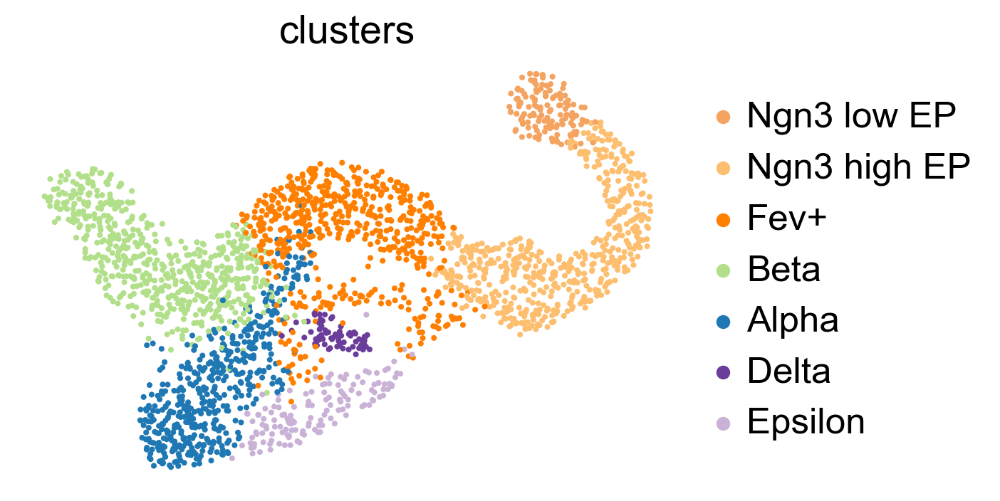

In [14]:
fig_kwargs = {'color': 'clusters', 'dpi': 100, 'legend_loc': 'right'}
if save_figure: fig_kwargs['save'] = "suppl_figures_pancreas/suppl_fig_annotations/annotation_clusters.pdf"
scv.pl.scatter(adata, **fig_kwargs)

saving figure to file /Users/marius/Projects/cellrank_reproducibility/figures/suppl_figures_pancreas/suppl_fig_annotations/annotations_clusters_fine.pdf


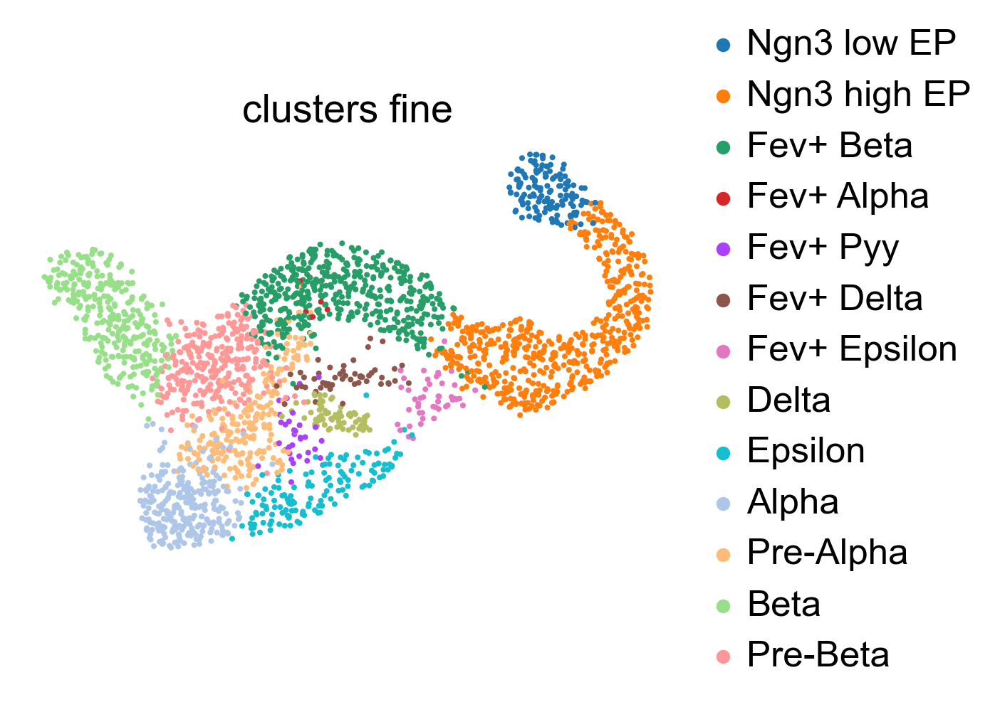

In [15]:
fig_kwargs = {'color': 'clusters_fine', 'dpi': 100, 'legend_loc': 'right'}
if save_figure: fig_kwargs['save'] = "suppl_figures_pancreas/suppl_fig_annotations/annotations_clusters_fine.pdf"
scv.pl.scatter(adata, **fig_kwargs)

Print cell type compotision

There are 70 Delta cells in the data


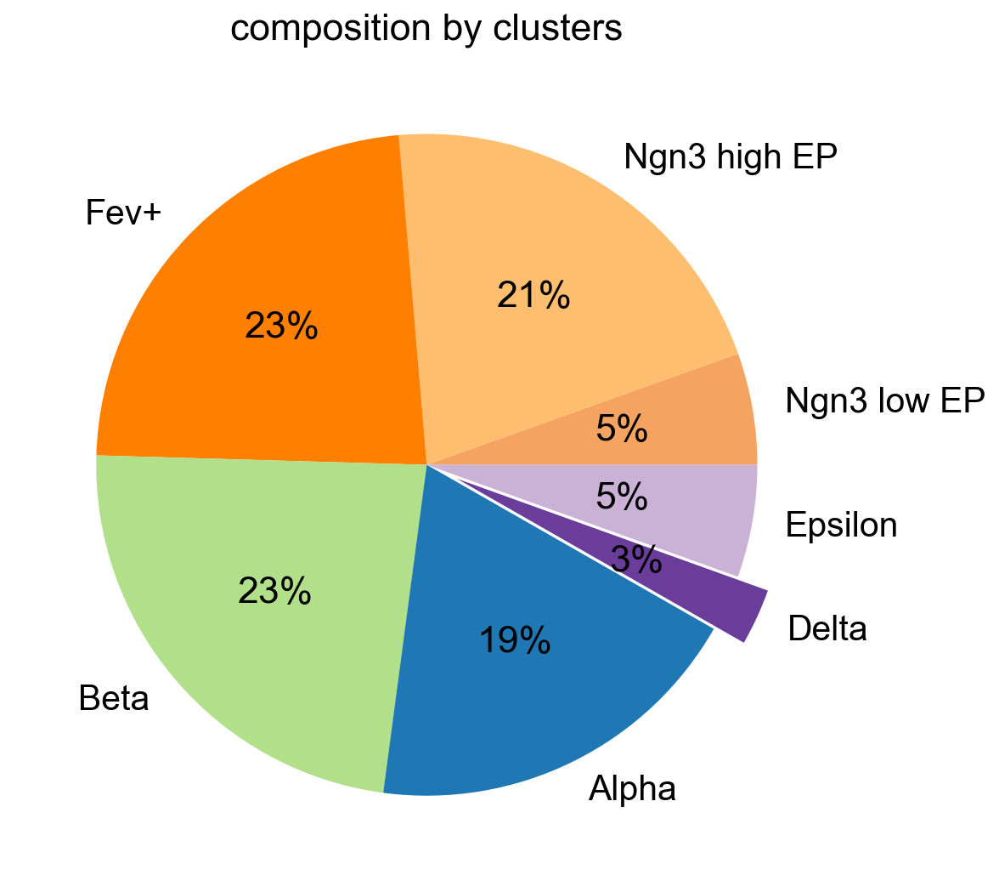

In [16]:
clusters = adata.obs['clusters'].cat.categories
explode = np.zeros(len(clusters))
mask = (clusters == 'Delta')
explode[mask] = 0.1

fig_kwargs = {'key': 'clusters', 'autopct': '%1.0f%%', 'explode': explode, 'figsize': (8, 8)}
if save_figure: fig_kwargs['save'] = "suppl_figures_pancreas/suppl_fig_annotations/clusters_composition.pdf"
cr.pl._utils.composition(adata, **fig_kwargs)

# print absolute number of Delta cells
print(f"There are {np.sum(adata.obs['clusters'] == 'Delta')} Delta cells in the data")

## Visualise marker gene expression

The following genes correspond either to hormones (terminal populations) or mark ductal cells (initial population):

saving figure to file /Users/marius/Projects/cellrank_reproducibility/figures/suppl_figures_pancreas/suppl_fig_annotations/initial_terminal_markers.pdf


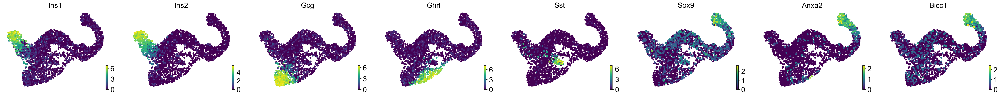

In [49]:
state_markers = ['Ins1', 'Ins2', 'Gcg', 'Ghrl', 'Sst', 'Sox9', 'Anxa2', 'Bicc1']
fig_kwargs = {'color': state_markers, 'size': 100}
if save_figure: fig_kwargs['save'] = 'suppl_figures_pancreas/suppl_fig_annotations/initial_terminal_markers.pdf'
scv.pl.scatter(adata_raw, **fig_kwargs)

## Compute velocities using scVelo

In [18]:
# compute/load from cache the dyn. model params and compute velocities
if use_caching:
    c.tl.recover_dynamics(adata, fname='2020-10-15_recover_dynamics', force=force_recompute)
else:
    scv.tl.recover_dynamics(adata)
    
scv.tl.velocity(adata, mode='dynamical')

Loading data from: `2020-10-15_recover_dynamics.pickle`.
computing velocities
    finished (0:00:02) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)


## Project velocities onto the embedding

Often, we want to show velocities in the UMAP embedding here.

computing velocity graph
    finished (0:00:03) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
saving figure to file /Users/marius/Projects/cellrank_reproducibility/figures/fig_2_pancreas_main/velocities_umap.pdf


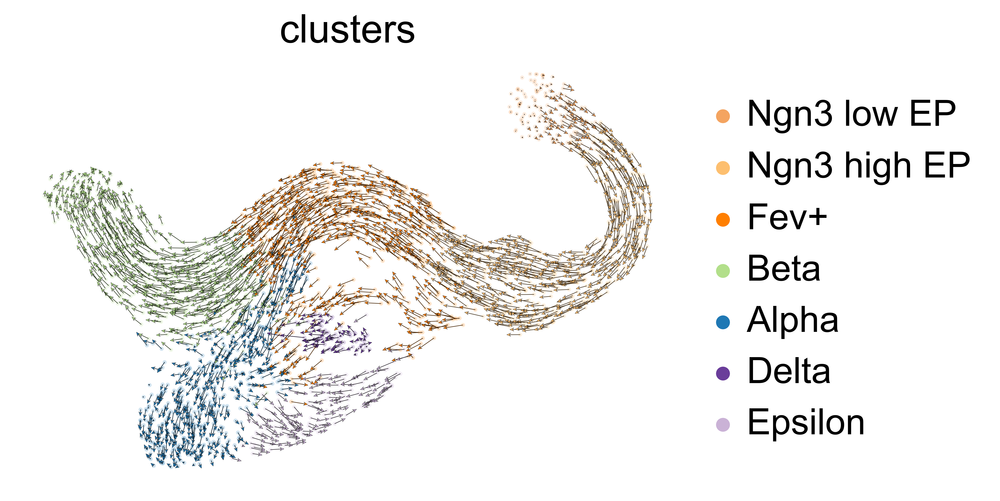

In [19]:
scv.tl.velocity_graph(adata)

fig_kwargs = {'color': ['clusters'],
                 'legend_loc': 'right', 'scale': 0.1, 'dpi': 400}
if save_figure: fig_kwargs['save'] = 'fig_2_pancreas_main/velocities_umap.pdf'
scv.pl.velocity_embedding(adata, **fig_kwargs)

## Look into gene-wise velocities

Look into the genes and mostly driver these velocities

saving figure to file /Users/marius/Projects/cellrank_reproducibility/figures/suppl_figures_pancreas/suppl_fig_velocity_genes/0_to_20.pdf


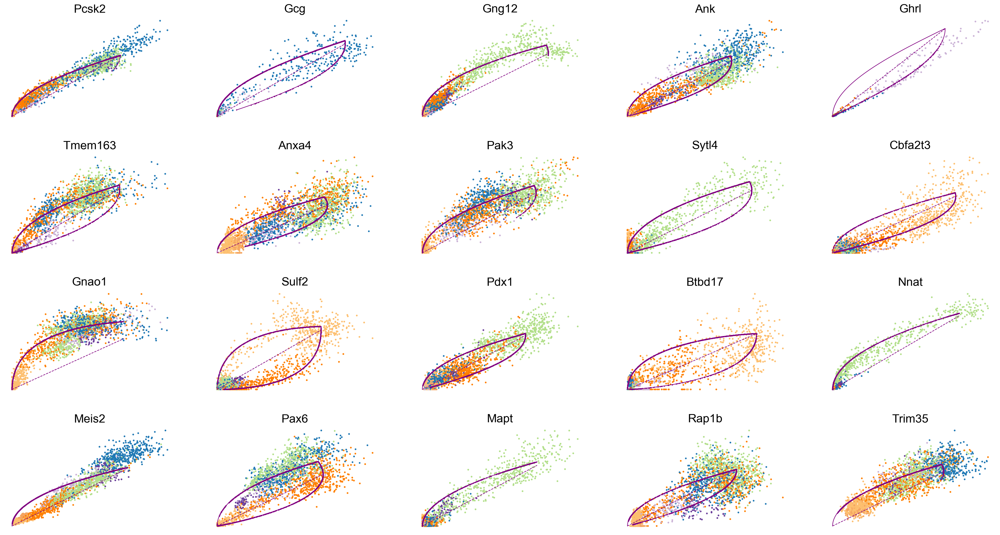

saving figure to file /Users/marius/Projects/cellrank_reproducibility/figures/suppl_figures_pancreas/suppl_fig_velocity_genes/20_to_30.pdf


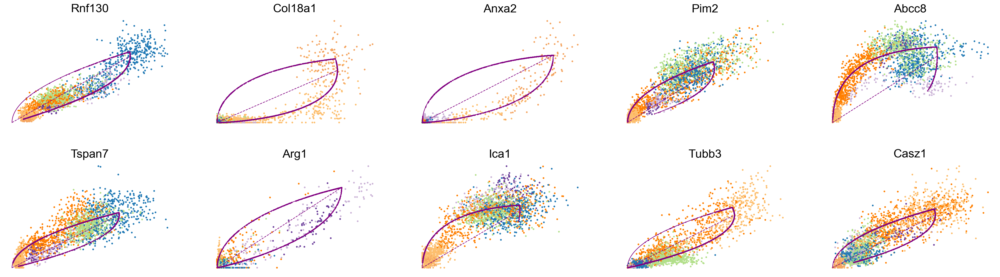

In [20]:
high_likelihood_genes = adata.var.sort_values('fit_likelihood', ascending=False).index

# plot the first 20 genes
fig_kwargs = {'basis': high_likelihood_genes[:20], 'frameon': False, 'ncols': 5}
if save_figure: fig_kwargs['save'] = 'suppl_figures_pancreas/suppl_fig_velocity_genes/0_to_20.pdf'
scv.pl.scatter(adata, **fig_kwargs)

# plot the remaining genes
fig_kwargs = {'basis': high_likelihood_genes[20:30], 'frameon': False, 'ncols': 5}
if save_figure: fig_kwargs['save'] = 'suppl_figures_pancreas/suppl_fig_velocity_genes/20_to_30.pdf'
scv.pl.scatter(adata, **fig_kwargs)

saving figure to file /Users/marius/Projects/cellrank_reproducibility/figures/suppl_figures_pancreas/suppl_fig_velocity_genes/known_delta_drivers.pdf


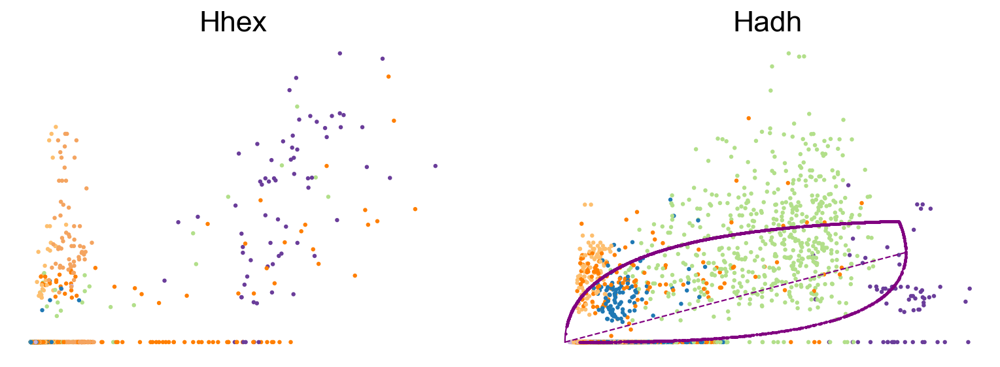

In [21]:
fig_kwargs = {'basis': ['Hhex', 'Hadh', 'Cd24a'], 'frameon': False}
if save_figure: fig_kwargs['save'] = 'suppl_figures_pancreas/suppl_fig_velocity_genes/known_delta_drivers.pdf' 
scv.pl.scatter(adata, **fig_kwargs)

# Run CellRank (Fig. 2)

## Initialise kernel and estimator

This serves as an example of how to cach a transition matrix and of the default values we should be using. 

In [22]:
from cellrank.tl.estimators import GPCCA

# set the parameters we want to use to compute the transition matrix
weight_connectivities=0.2
mode="stochastic" 
n_jobs=8
softmax_scale=None

if use_caching:
    c.tl.transition_matrix(adata, 
                           weight_connectivities=weight_connectivities, 
                           mode=mode, 
                           n_jobs=n_jobs, 
                           softmax_scale=softmax_scale, 
                           fname='2020-10-15_transition_matrix_stochastic', 
                           force=force_recompute)
    g_fwd = GPCCA(adata, obsp_key='T_fwd')
else:
    kernel = cr.tl.transition_matrix(adata, 
                                     weight_connectivities=weight_connectivities, 
                                     mode=mode, 
                                     n_jobs=n_jobs, 
                                     softmax_scale=softmax_scale)
    g_fwd = GPCCA(kernel)
    
print(g_fwd)

Loading data from: `2020-10-15_transition_matrix_stochastic.pickle`.
GPCCA[n=2531, kernel=<Precomputed[origin='array']>]


## Print transition matrix statistics for reproducibility

To make sure that we're using the same transition matrix, show some stats. 

In [23]:
# just for consistency, display some summary staes about the transition matrix
T = adata.obsp['T_fwd']
T_med, T_mean, T_var = np.median(T.data), np.mean(T.data), np.var(T.data)
T_min, T_max = np.min(T.data), np.max(T.data)

print(f'med = {T_med:.6f},\nmean = {T_mean:.6f},\nvar = {T_var:.6f},\nmin = {T_min:.6f},\nmax = {T_max:.6f}')

med = 0.018982,
mean = 0.024591,
var = 0.000451,
min = 0.000067,
max = 0.408090


## Compute the real Schur decomposition

Computing Schur decomposition
When computing macrostates, choose a number of states NOT in `[6, 9, 13, 15, 17]`
Adding `.eigendecomposition`
       `adata.uns['eig_fwd']`
       `.schur`
       `.schur_matrix`
    Finish (0:00:02)


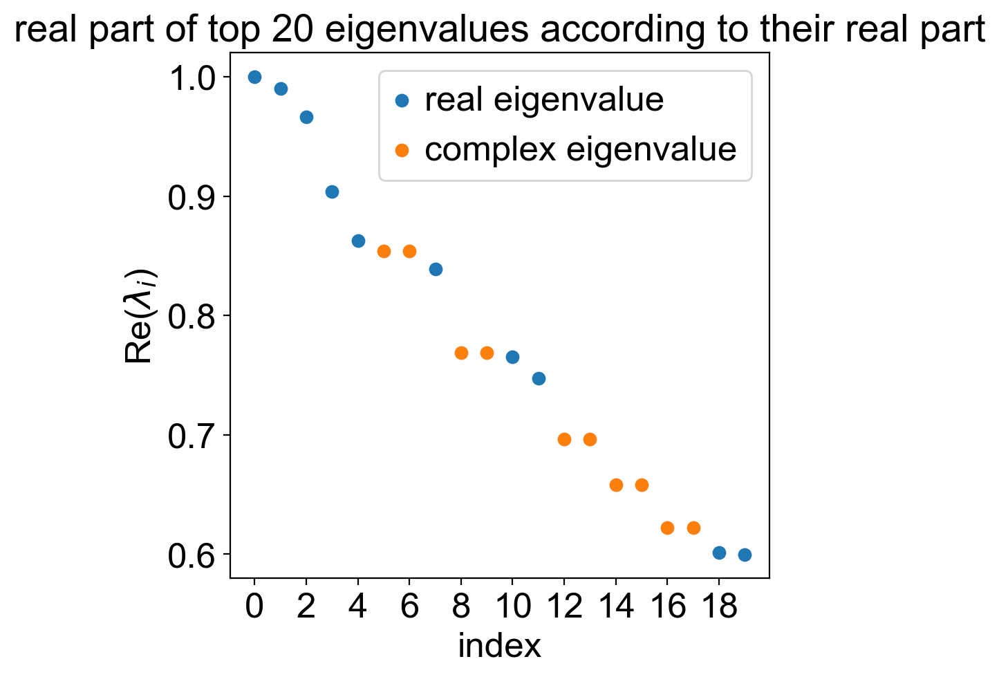

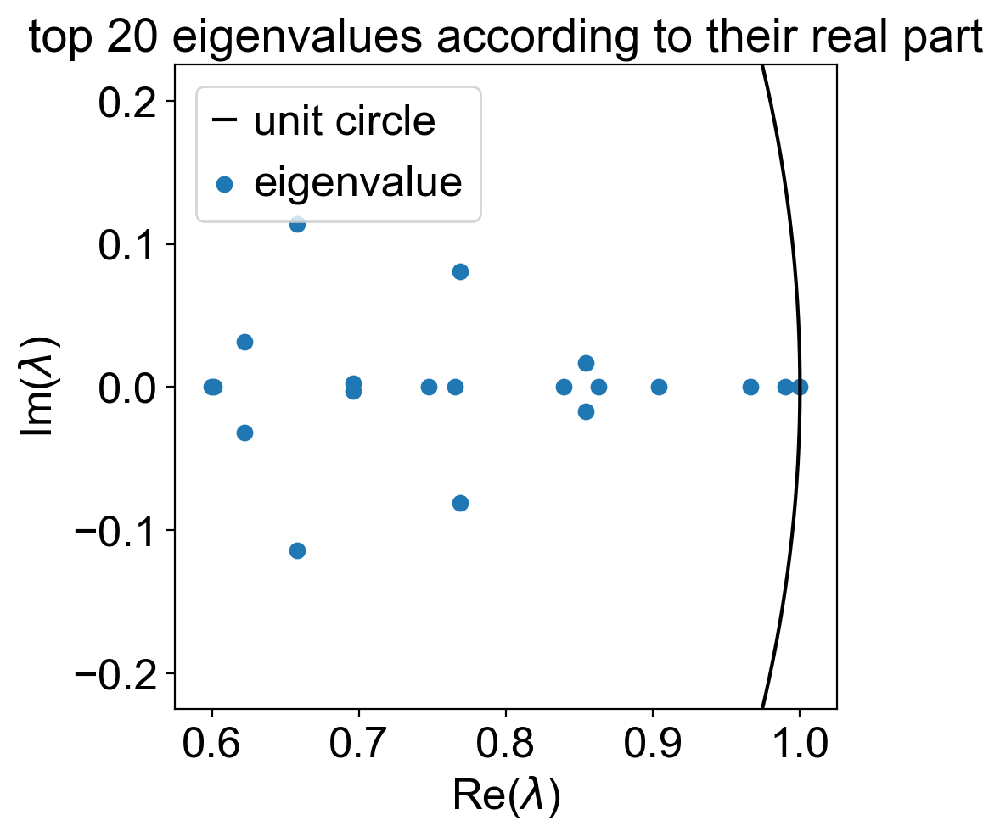

In [24]:
g_fwd.compute_schur(n_components=20)

fig_kwargs = {'real_only': True, 'show_eigengap': False, 'show_all_xticks': False, 's': 150}
if save_figure: fig_kwargs['save'] = 'suppl_figures_pancreas/suppl_fig_spectrum/real_part.pdf' 
g_fwd.plot_spectrum(**fig_kwargs)

fig_kwargs = {'real_only': False, 's': 150}
if save_figure: fig_kwargs['save'] = 'suppl_figures_pancreas/suppl_fig_spectrum/complex_plane.pdf' 
g_fwd.plot_spectrum(**fig_kwargs)

## Decompose dynamics into macrostates

Computing `12` macrostates
INFO: Using pre-computed schur decomposition
Adding `.macrostates_memberships`
       `.macrostates`
       `.schur`
       `.coarse_T`
       `.coarse_stationary_distribution`
    Finish (0:00:12)
saving figure to file /Users/marius/Projects/cellrank_reproducibility/figures/fig_2_pancreas_main/macrostates_umap.pdf


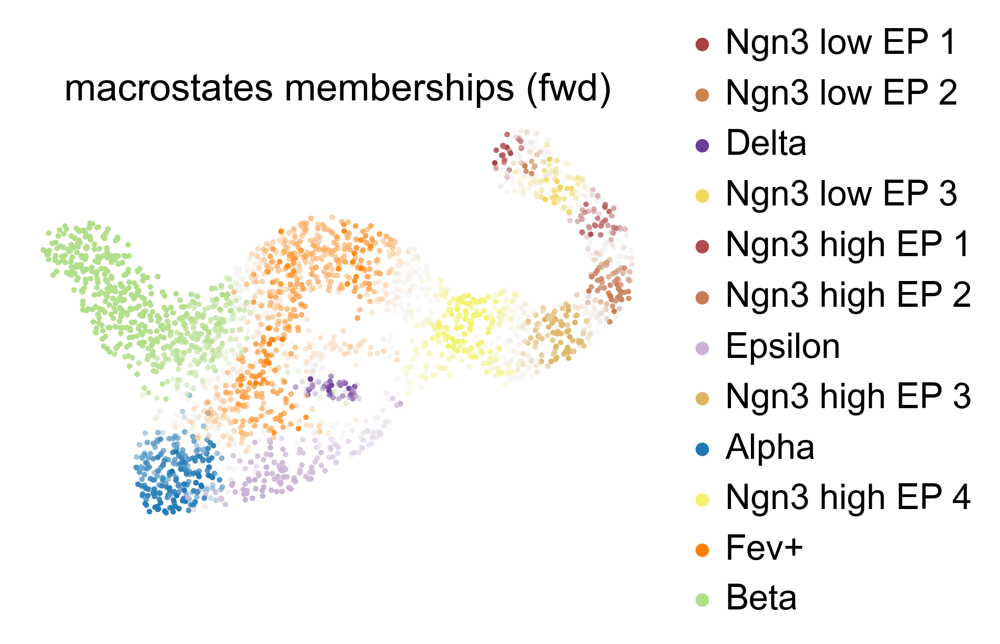

In [25]:
n_states = 12
g_fwd.compute_macrostates(cluster_key='clusters', n_states=n_states)

fig_kwargs = {'legend_loc': 'right', 'discrete': False, 'dpi':150}
if save_figure: fig_kwargs['save'] = 'fig_2_pancreas_main/macrostates_umap.pdf' 
g_fwd.plot_macrostates(**fig_kwargs)

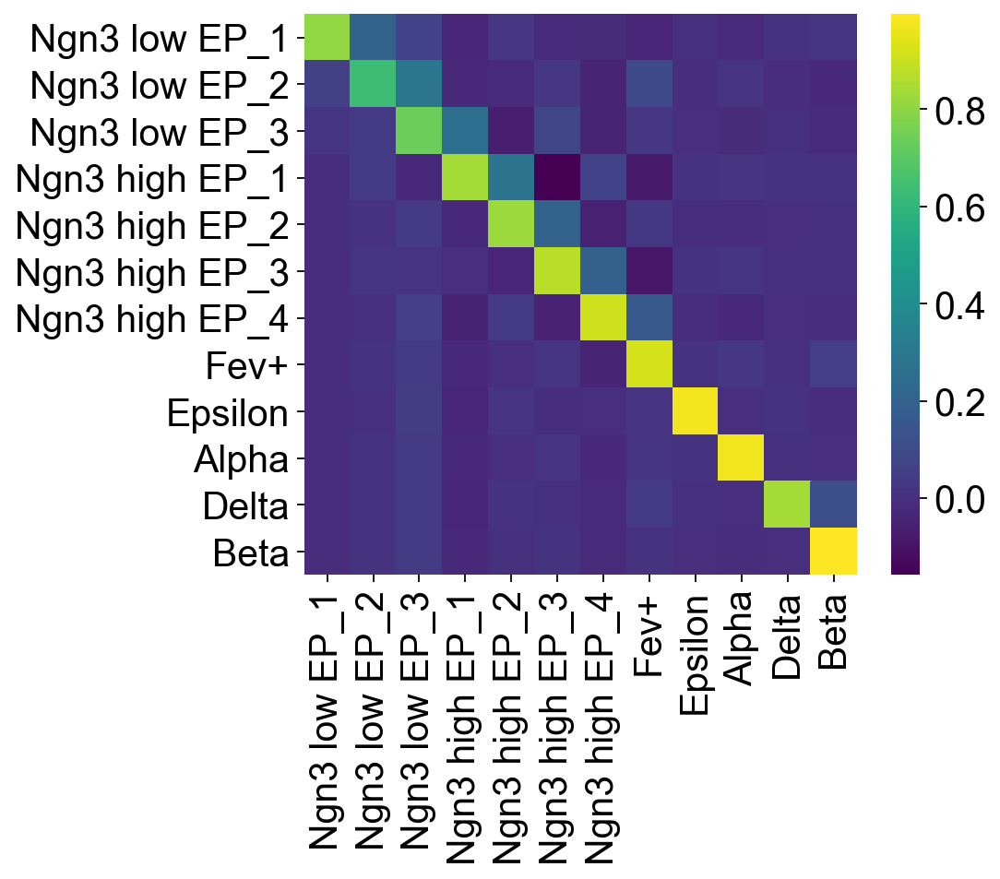

In [26]:
T_coarse = g_fwd.coarse_T
macro_names = ['Ngn3 low EP_1', 'Ngn3 low EP_2', 'Ngn3 low EP_3', 'Ngn3 high EP_1', 'Ngn3 high EP_2', 'Ngn3 high EP_3', 'Ngn3 high EP_4', 'Fev+', 'Epsilon', 'Alpha', 'Delta', 'Beta']

fig = plt.figure(None, (6, 5))
ax = fig.add_subplot(111)
sns.heatmap(T_coarse[macro_names].loc[macro_names], cmap='viridis', ax=ax)

if save_figure:
    plt.savefig(FIG_DIR / "fig_2_pancreas_main" / "t_coarse.pdf", bbox_inches='tight')

plt.show()

## Visualise the actual transition matrix

We want a visualisation of the transition matrix, where states are sorted according to their membership to macrostates. 

In [27]:
# get the transition matrix
T = adata.obsp['T_fwd'].A

# sort the cells by macrostate membership
macro_probs = g_fwd.macrostates_memberships[macro_names]
cell_assignment = macro_probs.argmax(1).X.flatten()

p = np.argsort(cell_assignment)
print(macro_probs.names)

['Ngn3 low EP_1' 'Ngn3 low EP_2' 'Ngn3 low EP_3' 'Ngn3 high EP_1'
 'Ngn3 high EP_2' 'Ngn3 high EP_3' 'Ngn3 high EP_4' 'Fev+' 'Epsilon'
 'Alpha' 'Delta' 'Beta']


Look at the distribution of non-zero values

<AxesSubplot:ylabel='Density'>

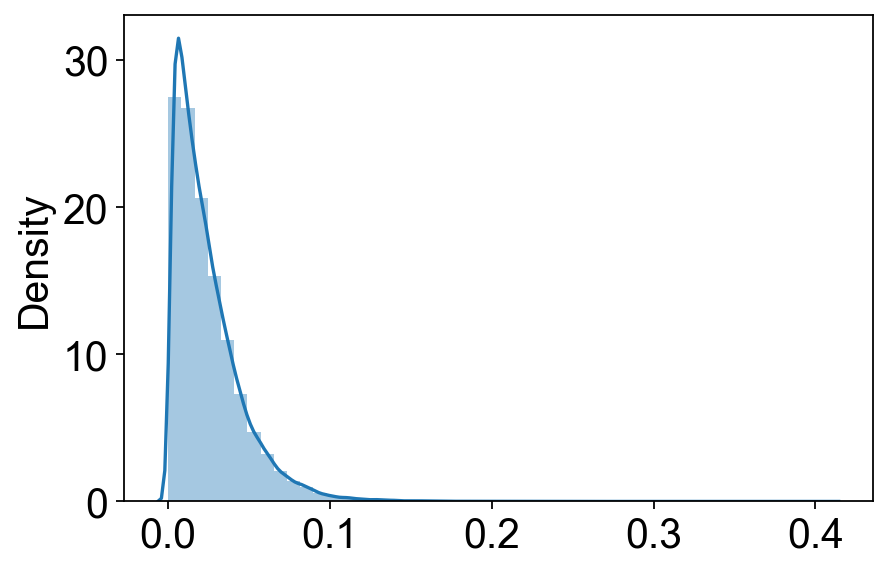

In [28]:
sns.distplot(T[T>0])

Plot the actual transition matrix

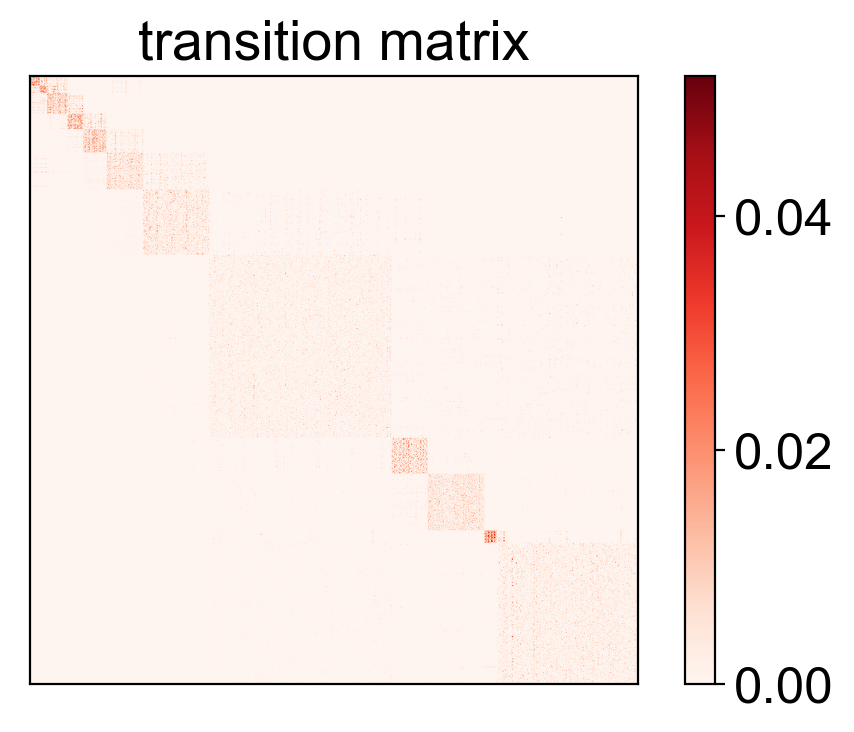

In [29]:
vmax = np.quantile(T[T>0], 0.90)

fig = plt.figure(None, dpi=100)
ax = fig.add_subplot(111)

cax = ax.imshow(T[p ,:][:, p], vmin=0, vmax=vmax, cmap='Reds', interpolation='sinc', filterrad=4.0)

ax.set_xticks([])
ax.set_yticks([])
ax.set_title('transition matrix')

plt.colorbar(mappable=cax)
if save_figure:
    plt.savefig(FIG_DIR / "suppl_figures_pancreas" / "suppl_fig_transition_matrix" / "t_sorted.pdf",
                bbox_inches='tight')
plt.show()

Same for the unsorted matrix to compare

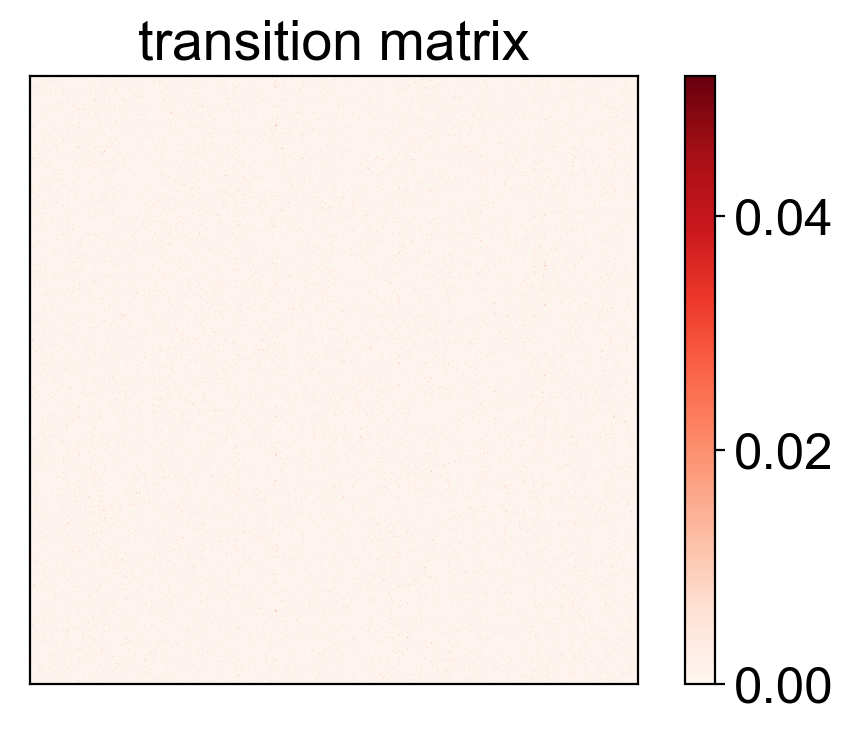

In [30]:
vmax = np.quantile(T[T>0], 0.90)

fig = plt.figure(None, dpi=100)
ax = fig.add_subplot(111)
cax = ax.imshow(T, vmin=0, vmax=vmax, cmap='Reds', interpolation='sinc', filterrad=4.0)

ax.set_xticks([])
ax.set_yticks([])
ax.set_title('transition matrix')

plt.colorbar(mappable=cax)
if save_figure:
    plt.savefig(FIG_DIR / "suppl_figures_pancreas" / "suppl_fig_transition_matrix" / "t_unsorted.pdf",
                bbox_inches='tight')
plt.show()

## Automatically identify initial and terminal states

Based on the coarse-grained transition matrix, automatically identify the terminal states of this system:

Adding `adata.obs['terminal_states_probs']`
       `adata.obs['terminal_states']`
       `adata.obsm['macrostates_fwd']`
       `.terminal_states_probabilities`
       `.terminal_states`


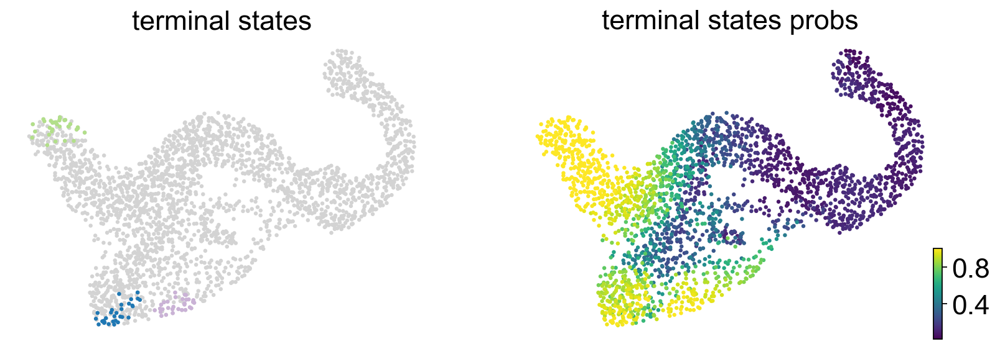

In [31]:
g_fwd.compute_terminal_states()
scv.pl.scatter(adata, c=['terminal_states', 'terminal_states_probs'], color_map='viridis')

We automatically found alpha, beta and epslion, consistent with known biology! However, we didn't capture the Delta state automatically - that's because it's very small (70) cells and splicing kinetics in that state fail to recolve the development (see our manuscript). None of the known Delta drivers are among them and for the actual drivers (Hhex, Cd24a), we don't have enough counts to reliably fit the phase portraits.  Therefore, we add the Delta state manually which is very simple in CellRank:

In [32]:
g_fwd.set_terminal_states_from_macrostates(names=['Alpha', 'Beta', 'Epsilon', 'Delta'])

Adding `adata.obs['terminal_states_probs']`
       `adata.obs['terminal_states']`
       `adata.obsm['macrostates_fwd']`
       `.terminal_states_probabilities`
       `.terminal_states`


For the initial states, we simply run

In [33]:
g_fwd._compute_initial_states()

Adding `adata.obs['initial_states_probs']`
       `adata.obs['initial_states']`



By default, this will compute a single initial state unless you tell it via `n_states` to compute more. We can check the identied state as well as the associated membership values:

saving figure to file /Users/marius/Projects/cellrank_reproducibility/figures/suppl_figures_pancreas/suppl_fig_palantir_pseudotime/initial_state.pdf


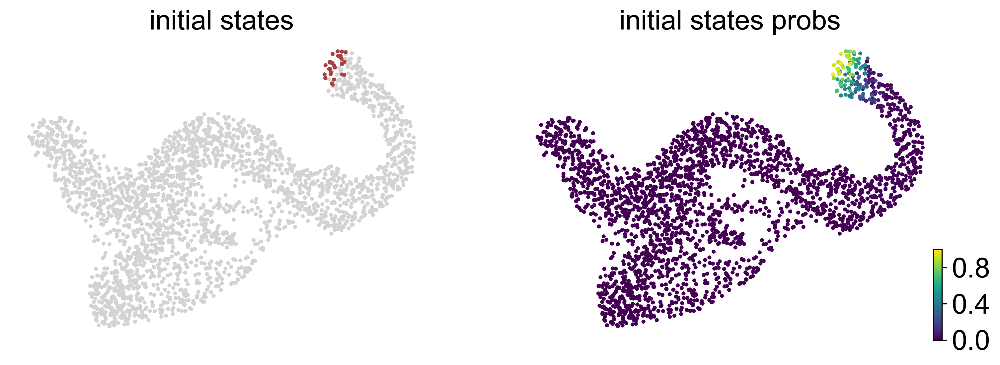

In [34]:
fig_kwargs = {'color':['initial_states', 'initial_states_probs'], 'color_map': 'viridis', 'dpi': 150}
if save_figure: fig_kwargs['save'] = 'suppl_figures_pancreas/suppl_fig_palantir_pseudotime/initial_state.pdf' 
scv.pl.scatter(adata, **fig_kwargs)

## Aggregate initial and terminal states

In [35]:
from cellrank.tl._utils import _create_initial_terminal_annotations

saving figure to file /Users/marius/Projects/cellrank_reproducibility/figures/fig_2_pancreas_main/initial_terminal.pdf


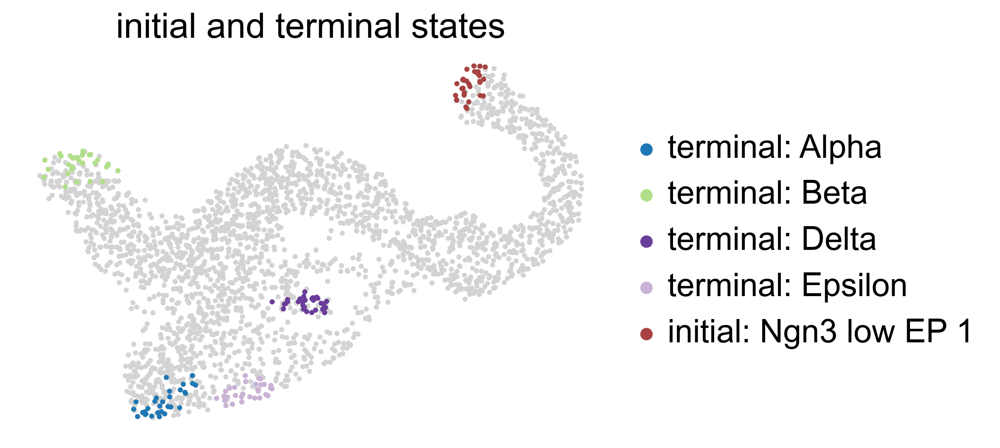

In [36]:
_create_initial_terminal_annotations(adata)

figure_params = {'title': f'initial and terminal states', 'legend_loc': 'right', 'dpi': 150, 
                 'color': 'initial_terminal'}
if save_figure: figure_params['save'] = "fig_2_pancreas_main/initial_terminal.pdf"
scv.pl.scatter(adata, **figure_params)

## Compute and plot fate probabilities

In [37]:
g_fwd.compute_absorption_probabilities()

Computing absorption probabilities
Adding `adata.obsm['to_terminal_states']`
       `adata.obs['to_terminal_states_dp']`
       `.absorption_probabilities`
       `.diff_potential`
    Finish (0:00:00)


saving figure to file /Users/marius/Projects/cellrank_reproducibility/figures/fig_2_pancreas_main/fate_probabilities.pdf


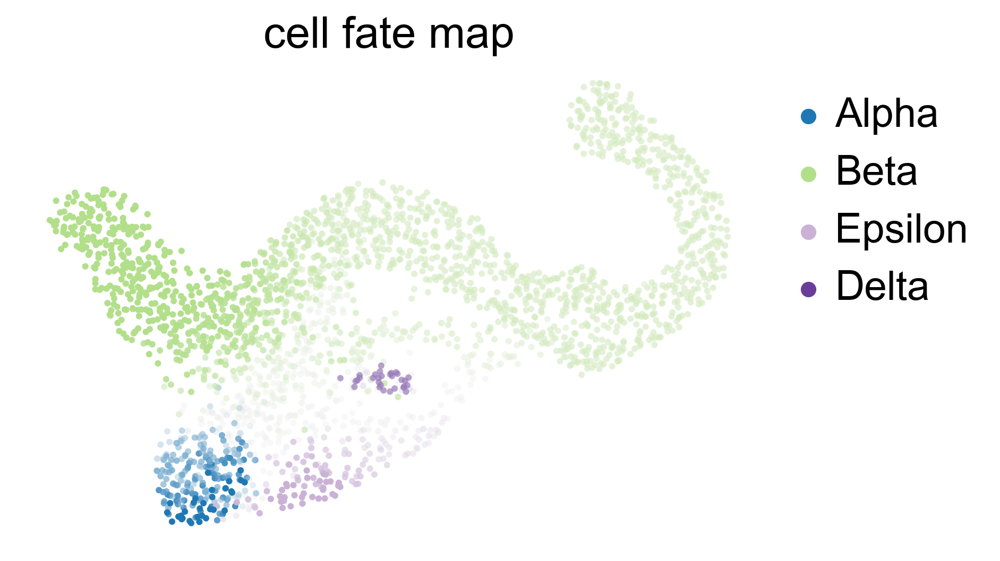

In [38]:
figure_kwargs = {'title': f'cell fate map', 'dpi': 150, 'same_plot': True}
if save_figure: figure_kwargs['save'] = "fig_2_pancreas_main/fate_probabilities.pdf"
g_fwd.plot_absorption_probabilities(**figure_kwargs)

## Aggregate fate probabilities to cluster level

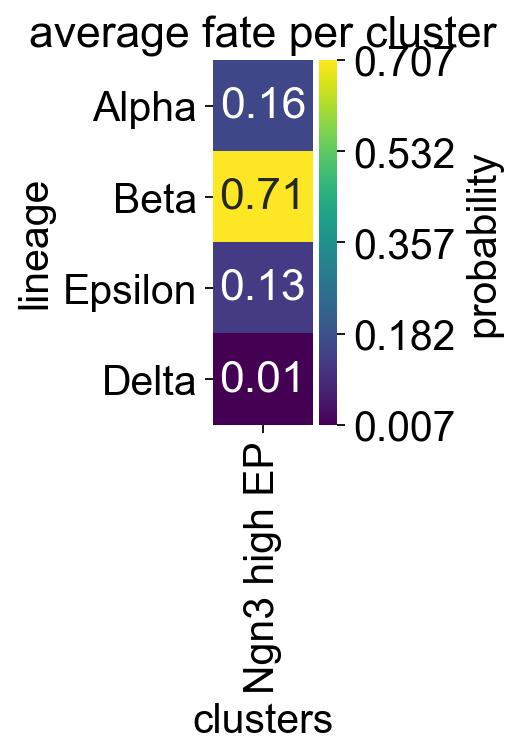

In [39]:
figure_kwargs = {'cluster_key': 'clusters', 
                 'mode': 'heatmap', 
                'lineages': ['Alpha', 'Beta', 'Epsilon', 'Delta'],
                 'clusters': ['Ngn3 high EP'], 'figsize': (1, 3)}
if save_figure: figure_kwargs['save'] = 'fig_2_pancreas_main/ngn3_high_fate_probs.pdf'
cr.pl.cluster_fates(adata, **figure_kwargs)

# Visualise gene expression trends

## Prepare for gene trend plotting

Set global gene-trend fitting parameters:

In [84]:
pseudotime = 'palantir_pseudotime'
data_key = 'magic_imputed_data'
n_splines = 10
weight_threshold = (0.05, 0.05)

For plotting, use the raw anndata object. Copy over the lineage probabilities. 

In [41]:
adata_raw.obsm['to_terminal_states'] = adata.obsm['to_terminal_states'].copy()
adata_raw.uns['terminal_states_colors'] = adata.uns['terminal_states_colors'].copy()
adata_raw.uns['to_terminal_states_colors'] = adata.uns['to_terminal_states_colors'].copy()

Check the initial and terminal state identification wich will be used to initialise latent time. 

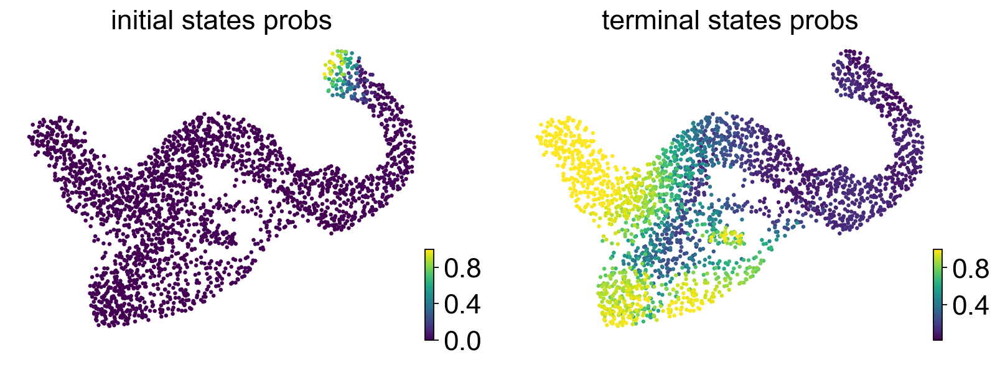

In [42]:
scv.pl.scatter(adata, color=['initial_states_probs', 'terminal_states_probs'], color_map='viridis')

Compute latent time

computing latent time using initial_states_probs, terminal_states_probs as prior
    finished (0:00:00) --> added 
    'latent_time', shared time (adata.obs)


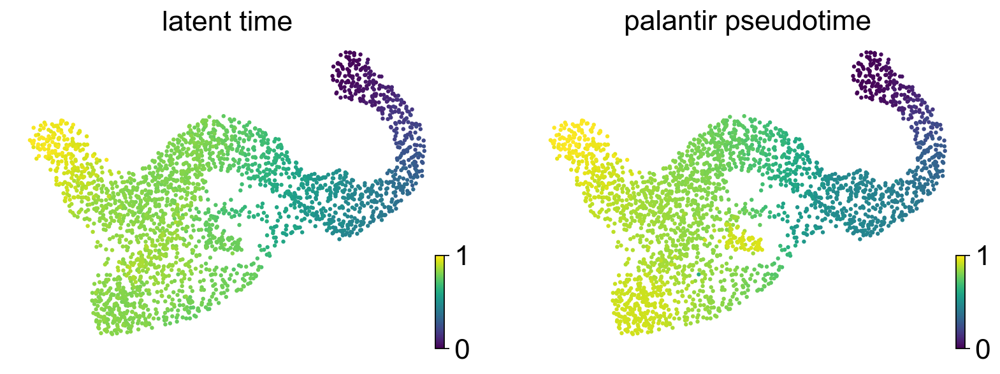

In [43]:
scv.tl.recover_latent_time(adata, root_key='initial_states_probs', end_key='terminal_states_probs')

# copy latent time over into the raw anndata object
adata_raw.obs['latent_time'] = adata.obs['latent_time'].copy()

scv.pl.scatter(adata_raw, color=['latent_time', 'palantir_pseudotime'], color_map='viridis')

## Visualise gene exp. trends (Fig. 2)

Plot for the pancres figure

Computing trends using `1` core(s)



    Finish (0:00:00)
Plotting trends


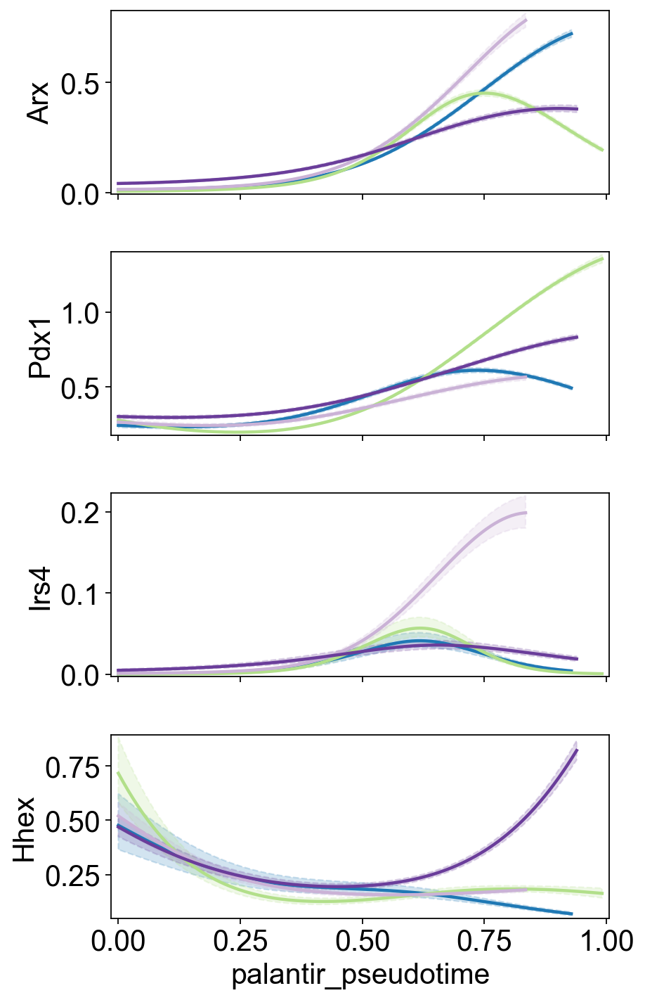

In [85]:
fig_2_genes = ['Arx', 'Pdx1', 'Irs4', 'Hhex']
model = cr.ul.models.GAM(adata_raw, n_splines=n_splines)

fig_kwargs = {'model': model,
              'data_key': data_key, 
              'gene_as_title': False, 
              'legend_loc': None,
              'genes': fig_2_genes, 
              'ncols': 1,
              'time_key': pseudotime, 
              'same_plot': True, 
              'hide_cells': True,
              'weight_threshold': weight_threshold, 
              'figsize': (6, 9), 
              'suptitle': ''}

if save_figure: fig_kwargs['save'] = 'fig_2_pancreas_main/gene_trends.pdf'

cr.pl.gene_trends(adata_raw, **fig_kwargs)

saving figure to file /Users/marius/Projects/cellrank_reproducibility/figures/fig_2_pancreas_main/gene_expression_umap.pdf


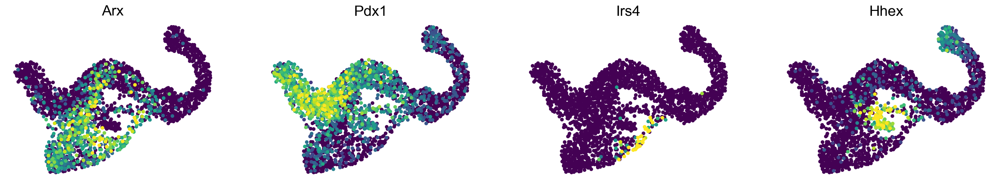

In [45]:
fig_kwargs = {'color': fig_2_genes, 'perc': [0, 99], 'title': fig_2_genes, 'size': 100, 'colorbar': False}
if save_figure: fig_kwargs['save'] = 'fig_2_pancreas_main/gene_expression_umap.pdf'
scv.pl.scatter(adata_raw, **fig_kwargs)

## Visualise gene exp. trends (Fig. 5)

Computing trends using `1` core(s)



    Finish (0:00:00)
Plotting trends


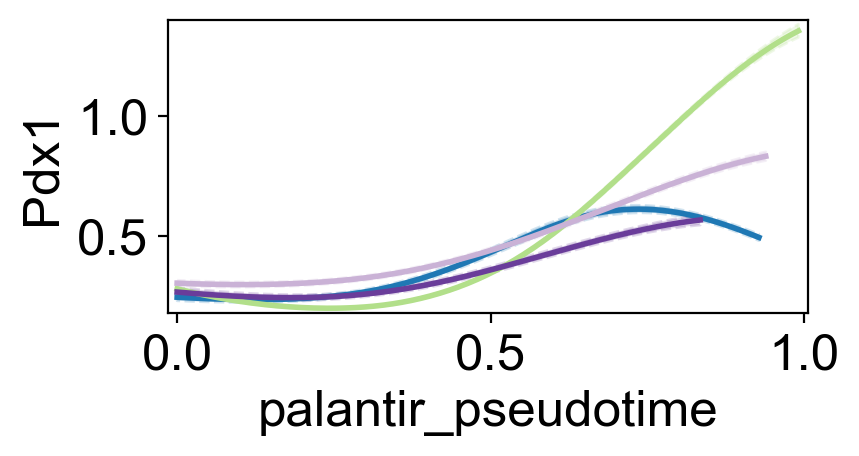

In [46]:
model = cr.ul.models.GAM(adata_raw, n_splines=n_splines)

fig_kwargs = {'model': model,
              'data_key': data_key, 
              'gene_as_title': False, 
              'legend_loc': None,
              'genes': ['Pdx1'],
              'ncols': 1,
              'dpi': 100,
              'time_key': pseudotime, 
              'same_plot': True, 
              'hide_cells': True,
              'weight_threshold': weight_threshold, 
              'figsize': (4.5, 2.5), 
              'suptitle': ''}

if save_figure: fig_kwargs['save'] = 'fig_5_benchmarking/cellrank/gene_trend_pdx1.pdf'

cr.pl.gene_trends(adata_raw, **fig_kwargs)

## Visualise gene expression trends (supplement)

Computing trends using `1` core(s)



    Finish (0:00:01)
Plotting trends


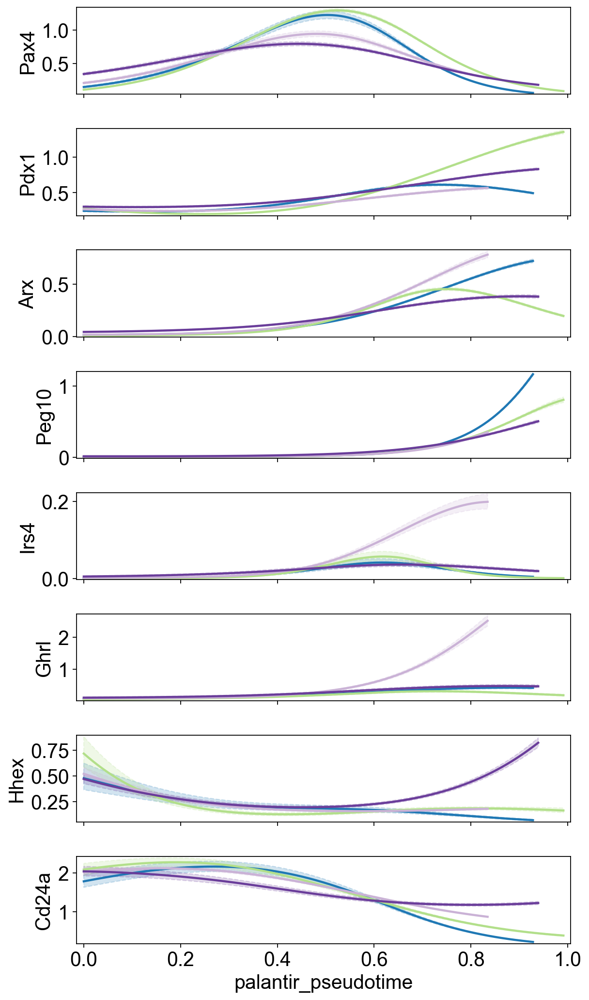

In [47]:
model = cr.ul.models.GAM(adata_raw, n_splines=n_splines)
suppl_genes = ['Pax4', 'Pdx1', 'Arx', 'Peg10', 'Irs4', 'Ghrl', 'Hhex', 'Cd24a']

fig_kwargs = {'model': model,
              'data_key': data_key, 
              'gene_as_title': False, 
              'legend_loc': None,
              'genes': suppl_genes,
              'ncols': 1,
              'time_key': pseudotime, 
              'same_plot': True, 
              'hide_cells': True,
              'weight_threshold': weight_threshold, 
              'figsize': (8, 13), 
              'suptitle': ''}

if save_figure: fig_kwargs['save'] = 'suppl_figures_pancreas/suppl_fig_gene_trends/gene_trends.pdf'

cr.pl.gene_trends(adata_raw, **fig_kwargs)

saving figure to file /Users/marius/Projects/cellrank_reproducibility/figures/suppl_figures_pancreas/suppl_fig_gene_trends/gene_expression_0_to_4.pdf


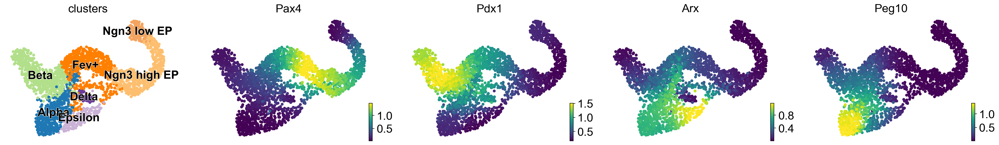

saving figure to file /Users/marius/Projects/cellrank_reproducibility/figures/suppl_figures_pancreas/suppl_fig_gene_trends/gene_expression_4_to_8.pdf


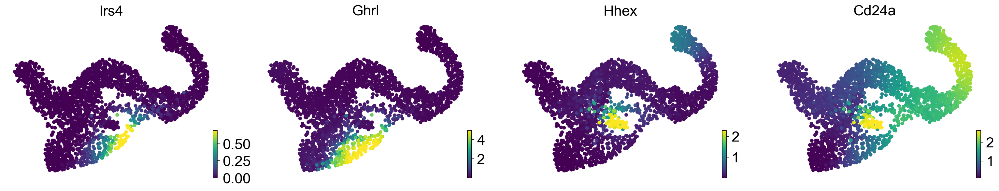

In [48]:
fig_kwargs = {'color': ['clusters'] + suppl_genes[:4], 'layer': data_key, 'title': ['clusters'] + suppl_genes[:4], 
             'perc': [0, 99], 'legend_loc': 'on data', 'size': 100}
if save_figure: fig_kwargs['save'] = 'suppl_figures_pancreas/suppl_fig_gene_trends/gene_expression_0_to_4.pdf'
scv.pl.scatter(adata_raw, **fig_kwargs)

fig_kwargs = {'color': suppl_genes[4:], 'layer': data_key, 'title': suppl_genes[4:], 
             'perc': [0, 99], 'legend_loc': 'on data', 'size': 100}
if save_figure: fig_kwargs['save'] = 'suppl_figures_pancreas/suppl_fig_gene_trends/gene_expression_4_to_8.pdf'
scv.pl.scatter(adata_raw, **fig_kwargs)

# Look into delta cell differentiation (Fig. 3)

## Visualise and compare fate probabilities

Compute lineage drivers towards the Delta lineage

saving figure to file /Users/marius/Projects/cellrank_reproducibility/figures/fig_3_pancreas_delta/fate_probabilities.pdf


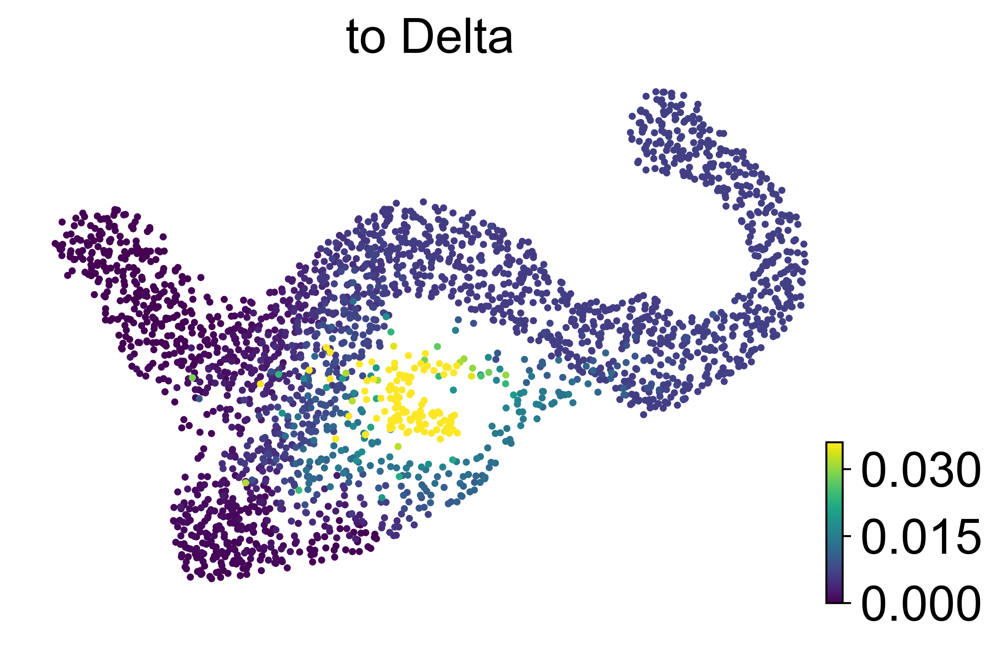

In [75]:
fig_kwargs = {'same_plot': False, 'perc': [0, 96], 'dpi': 200, 'lineages': ['Delta'], 'show_dp': False}
if save_figure: fig_kwargs['save'] = 'fig_3_pancreas_delta/fate_probabilities.pdf'
g_fwd.plot_absorption_probabilities(**fig_kwargs)

Show and quantify lineage bias towards Delta

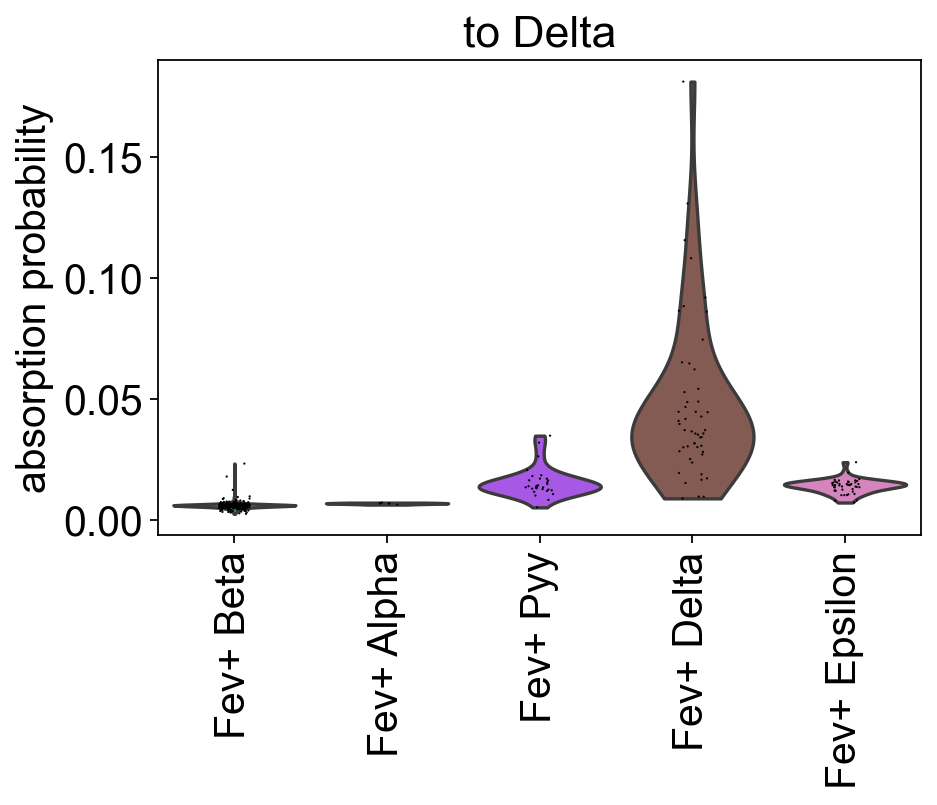

In [53]:
fev_clusters = ['Fev+ Beta', 'Fev+ Alpha', 'Fev+ Delta', 'Fev+ Epsilon', 'Fev+ Pyy']
fig_kwargs = {'mode': 'violin', 'lineages': ['Delta'], 'cluster_key': 'clusters_fine', 'clusters': fev_clusters}
if save_figure: fig_kwargs['save'] = 'fig_3_pancreas_delta/violin_fate_probs_fev_clusters.pdf'
cr.pl.cluster_fates(adata, **fig_kwargs)

Perform two-sided Welch's t-test (not assuming equal variances) to show that the Fev+ Delta cluster is assigned highest Delta probabilities by CellRank:

In [54]:
from scipy.stats import ttest_ind

fate_probs = g_fwd.absorption_probabilities['Delta']
mask_background = np.in1d(adata.obs['clusters_fine'], ['Fev+ Beta', 'Fev+ Alpha', 'Fev+ Epsilon', 'Fev+ Pyy'])
mask_target = np.in1d(adata.obs['clusters_fine'], ['Fev+ Delta'])

background = fate_probs[mask_background]
target = fate_probs[mask_target]
print(f"There are {np.sum(mask_background)} cell in the background and {np.sum(mask_target)} cell in the target.")

ttest_ind(target, background, equal_var=False)

There are 536 cell in the background and 51 cell in the target.


Ttest_indResult(statistic=array([8.63586127]), pvalue=array([1.72315556e-11]))

## Show potential lineage drivers in heatmap

Compute potential lineage drivers through correlating gene expression with fate probabilities:

In [56]:
g_fwd.compute_lineage_drivers(lineages=['Delta'], cluster_key='clusters', clusters=['Fev+'], 
                              use_raw=True)
delta_corr = adata.raw.var.sort_values(by='to Delta', ascending=False)
delta_corr = delta_corr.head(50)
print(f"Selected {len(delta_corr)} genes")

Computing correlations for lineages `['Delta']` restricted to clusters `['Fev+']` in layer `X` with `use_raw=True`
Adding `.lineage_drivers`
       `adata.raw.var['to Delta']`
    Finish (0:00:00)
Selected 50 genes


Plot the gene expression trends as a heatmap

Computing trends using `1` core(s)



    Finish (0:00:02)


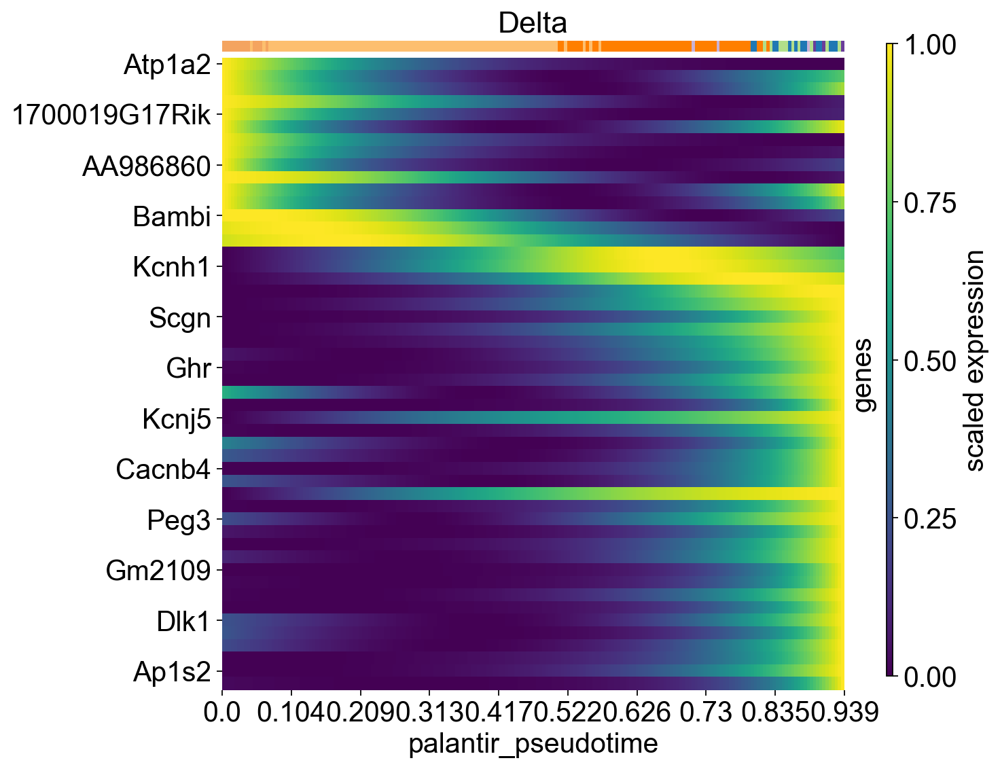

In [65]:
model = cr.ul.models.GAM(adata_raw, n_splines=n_splines)
fig_kwargs = {'model': model, 
              'genes': delta_corr.index, 
              'lineages': ['Delta'], 
              'cluster_key': 'clusters', 
              'data_key': data_key, 
              'time_key': pseudotime, 
              'show_absorption_probabilities': False, 
              'figsize': (10, 8), 
              'show_all_genes': False, 
              'weight_threshold': weight_threshold}
if save_figure: fig_kwargs['save'] = 'fig_3_pancreas_delta/heatmap_small.pdf'
    
cr.pl.heatmap(adata_raw, **fig_kwargs) 

Plot an extended version with all gene names included:

Computing trends using `1` core(s)



    Finish (0:00:02)


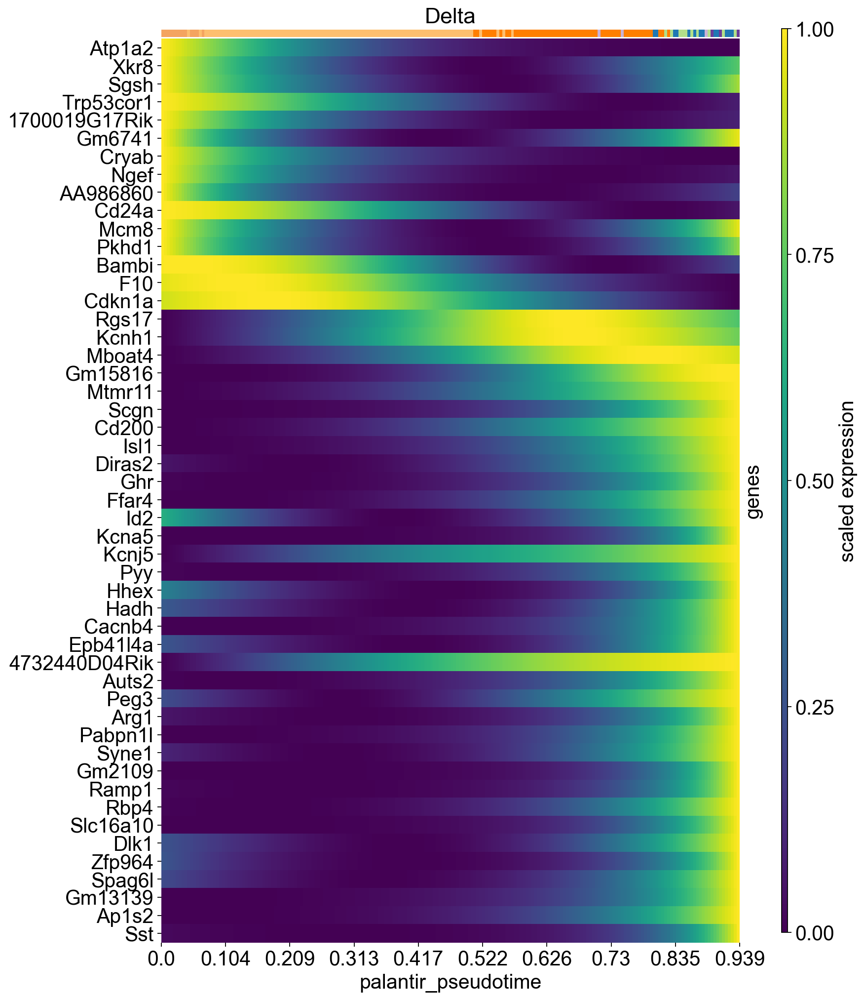

In [67]:
model = cr.ul.models.GAM(adata_raw, n_splines=n_splines)
fig_kwargs = {'model': model, 
              'genes': delta_corr.index, 
              'lineages': ['Delta'], 
              'cluster_key': 'clusters', 
              'data_key': data_key, 
              'time_key': pseudotime, 
              'show_absorption_probabilities': False, 
              'figsize': (12, 15), 
              'show_all_genes': True, 
              'weight_threshold': weight_threshold}
if save_figure: fig_kwargs['save'] = 'fig_3_pancreas_delta/heatmap_large.pdf'
    
cr.pl.heatmap(adata_raw, **fig_kwargs)  

saving figure to file /Users/marius/Projects/cellrank_reproducibility/figures/fig_3_pancreas_delta/known_genes.pdf


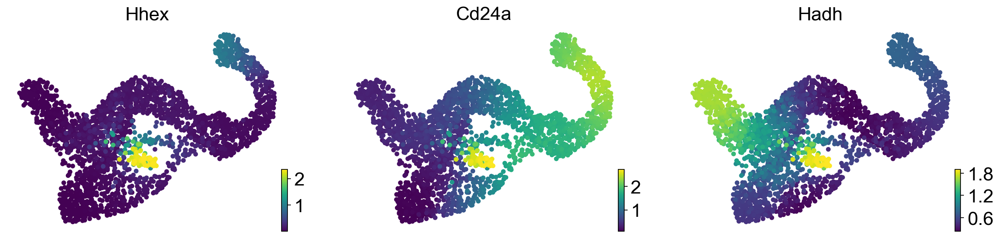

In [73]:
delta_genes = ['Hhex', 'Cd24a', 'Hadh']
fig_kwargs = {'color': delta_genes, 'size': 100, 'layer': 'magic_imputed_data', 'title': delta_genes}
if save_figure: fig_kwargs['save'] = 'fig_3_pancreas_delta/known_genes.pdf'
scv.pl.scatter(adata_raw, **fig_kwargs)

## Cluster trends towards the delta fate

Next, we want to cluster gene expression trends along the Delta lineage. 

Computing trends using `8` core(s)



    Finish (0:05:19)
computing PCA
    with n_comps=49
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 49
    finished (0:00:05)
running Louvain clustering
running Leiden clustering
    finished (0:00:00)
Saving data to `adata.uns['lineage_Delta_trend']`


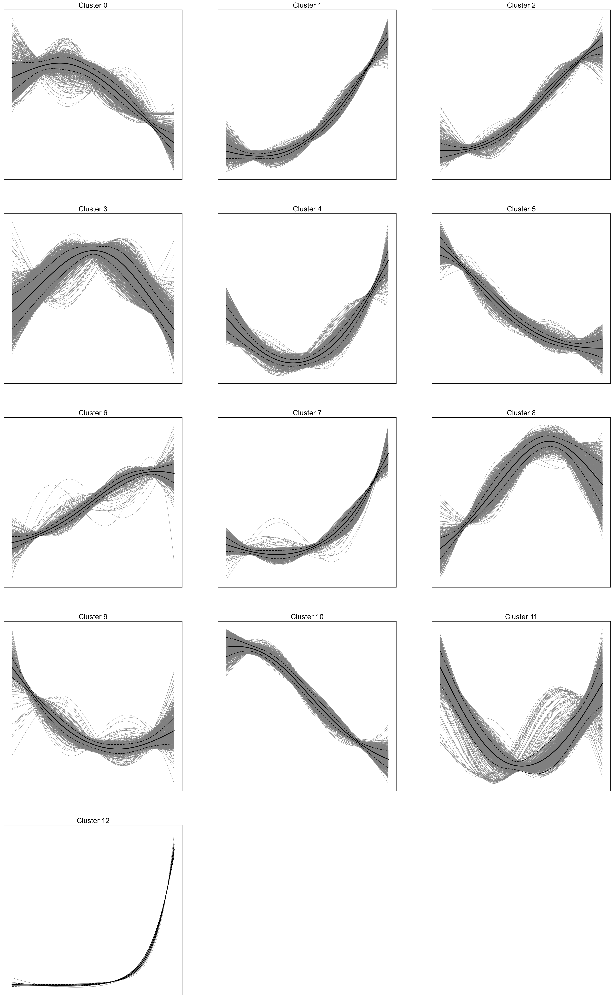

In [77]:
model = cr.ul.models.GAM(adata_raw, n_splines=n_splines)
cr.pl.cluster_lineage(
    adata_raw,
    model, 
    adata_raw.var_names,
    lineage="Delta",
    time_key=pseudotime, 
    n_jobs=8, 
    data_key=data_key, 
    recompute=True, 
    random_state=0, 
    weight_threshold=weight_threshold,
    clustering_kwargs={'resolution': 0.2, 'random_state': 0}, neighbors_kwargs={'random_state': 0}
)

The results are saved in an AnnData object, which is actually stored within the current AnnData object!

In [78]:
gdata = adata_raw.uns['lineage_Delta_trend'].copy()

Select genes from a particular cluster

In [98]:
gene_clusters = ['8'] 

mask = np.in1d(gdata.obs['clusters'], gene_clusters)
gene_df = gdata[mask].obs

Let's rank these genes according to their correlation with Delta fate probs

In [99]:
# re-compute linege drivers, using also the earlier clusters
g_fwd.compute_lineage_drivers(lineages=['Delta'], cluster_key='clusters', 
                              clusters=['Fev+'], use_raw=True)

gene_df = gene_df.join(adata.raw.var)
gene_df = gene_df.sort_values(by='to Delta', ascending=False)
gene_df.head(10)

Computing correlations for lineages `['Delta']` restricted to clusters `['Fev+']` in layer `X` with `use_raw=True`
Adding `.lineage_drivers`
       `adata.raw.var['to Delta']`
    Finish (0:00:00)


,clusters,highly_variable_genes,n_cells,gene_count_corr,highly_variable,means,dispersions,dispersions_norm,to Delta
Kcnh1,8,False,20,-0.0058,False,0.008114,0.096954,0.164585,0.274938
Rgs17,8,True,1421,-0.1908,True,0.829513,1.030133,2.187948,0.274571
Casp9,8,False,66,-0.0102,False,0.025006,-0.014407,-0.537354,0.174395
Cct6b,8,False,11,-0.0063,False,0.004378,0.032122,-0.244066,0.153776
Map2k4,8,False,405,-0.0093,False,0.158635,0.018731,-0.328474,0.138118
Pitpna,8,False,906,-0.0008,False,0.355539,0.021609,-0.501339,0.134115
Igsf21,8,True,315,-0.1217,True,0.158225,0.448968,2.383426,0.130143
Msi1,8,True,509,-0.0700,True,0.211516,0.200057,0.814472,0.128597
Syt5,8,True,582,-0.1099,True,0.265239,0.332454,1.047733,0.122458
Enho,8,True,1034,-0.0800,True,0.575285,0.661961,1.801519,0.121736


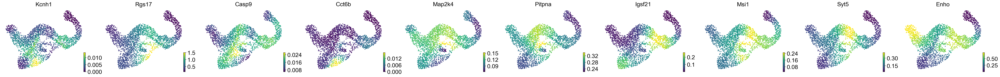

In [100]:
names = list(gene_df.index[:10])
scv.pl.scatter(adata_raw, c=names, layer=data_key, title=names, 
               perc=[0, 99])

Interesting genes
- Nefl: regulated by FOS which is infolved in differentiation
- Msi1: regulated by Rfx4 which may play a role in early brain differentiation

Grab a subset of these genes

[4 7]


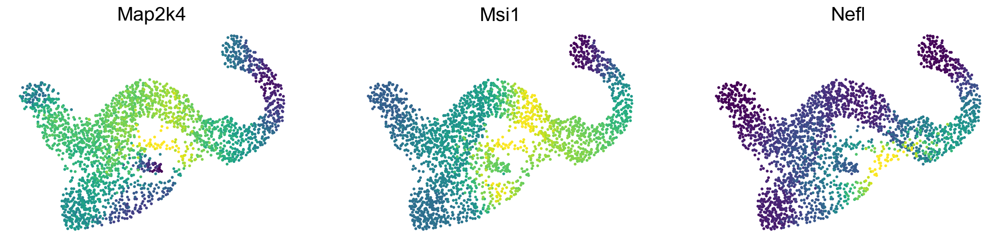

In [102]:
# names = ['Map2k4', 'Msi1', 'Tox2']
# names = [ 'Emb', 'Trnp1', 'Pitpna']
names = ['Map2k4', 'Msi1', 'Nefl']

# Msi1 is regulated by Rfx4 which may be involved in brain development

# where are these in the long dataframe? [6, 13, 39]
print(np.where(np.in1d(gene_df.index, names))[0])

# plot these genes
scv.pl.scatter(adata_raw, c=names, layer=data_key, title=names,
               perc=[0, 99], colorbar=False)